In [135]:
import os
os.environ["KERAS_BACKEND"] = "torch" # alternatively you can use jax or tensorflow as the backend (see installation instructions in keras documentation)
import keras

import numpy as np
import matplotlib.pyplot as plt

from sklearn.model_selection import train_test_split # helpful for splitting data into training and testing sets
from sklearn.preprocessing import StandardScaler, MinMaxScaler # helpful for scaling data to be between 0 and 1 or have a mean of 0 and standard deviation of 1


In [136]:
file_path = '/Users/ctychen/Desktop/N3AS/spectrum_data/'
#reloading data
parameters = np.concatenate([np.load(file_path + "atm_retr_params_12800_"+str(i)+".npy") for i in range(12)])
spectra_set = np.concatenate([np.load(file_path + "atm_retr_data_12800_"+str(i)+".npy") for i in range(12)])

#take the log of the spectra - seems like this helped a lot with feature identification
spectra_set = np.log(spectra_set)

parameters = parameters[~np.isnan(spectra_set).any(axis=1)]
spectra_set = spectra_set[~np.isnan(spectra_set).any(axis=1)]

print(parameters.shape)
print(spectra_set.shape)

n_samples = parameters.shape[0]
n_features = 947

max_log_flux = np.max(spectra_set, axis=1)
min_log_flux = np.min(spectra_set, axis=1)
spectra_set = (spectra_set - min_log_flux[:, np.newaxis])/(max_log_flux - min_log_flux)[:, np.newaxis]

(153590, 16)
(153590, 947)


In [215]:
# https://stackoverflow.com/questions/14313510/how-to-calculate-rolling-moving-average-using-python-numpy-scipy 

# def moving_average(a, n=3):
#     ret = np.cumsum(a, dtype=float)
#     ret[n:] = ret[n:] - ret[:-n]
#     return ret[n - 1:] / n

def moving_average(x, n=3):
    return np.convolve(x, np.ones(n), 'valid') / n

averaged_spectra_set = np.array([moving_average(spectra_set[i], n=3) for i in range(n_samples)])

#sample every 5th point  ---- this ends up not working that well compared to the moving average
# averaged_spectra_set = np.array([spectra_set[i][::10] for i in range(n_samples)])

In [216]:
#let's see how well max-abs-diff with averaged spectra, work as a metric for finding weird spectra... 
max_absolute_differences = np.max(np.abs(np.diff(averaged_spectra_set, axis=1)), axis=1)    
print(max_absolute_differences.shape)

(153590,)


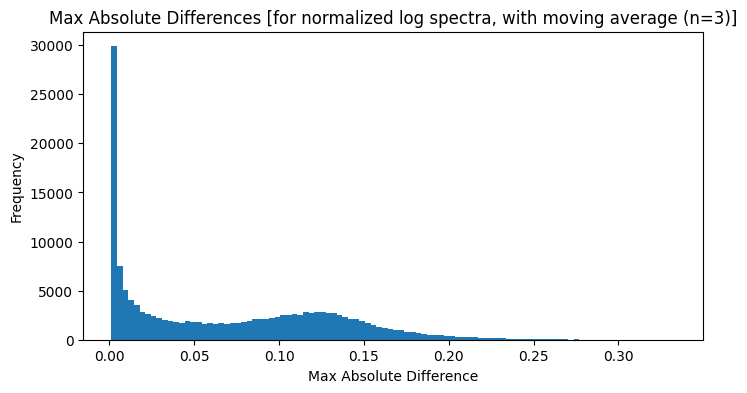

In [217]:
#what does the distribution of max absolute differences look like?
plt.figure(figsize=(8, 4))
plt.hist(max_absolute_differences, bins=100)
plt.title('Max Absolute Differences [for normalized log spectra, with moving average (n=3)]')
plt.xlabel('Max Absolute Difference')
plt.ylabel('Frequency')
# plt.show()
figdir = '/Users/ctychen/Desktop/N3AS/figures/'
plt.savefig(figdir + 'max_abs_diff_log_spectra_distribution_averaged_n_3.png')

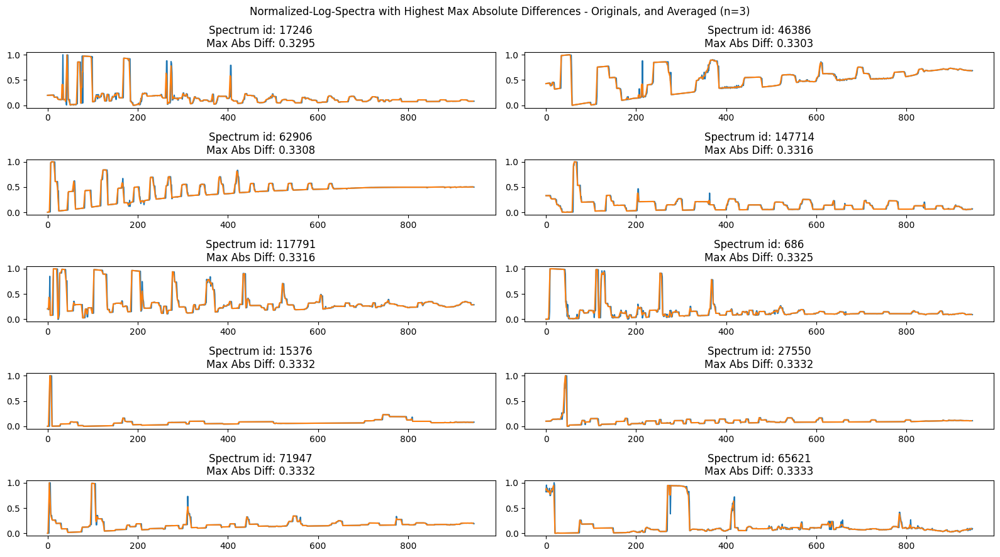

In [218]:
#what do the 10 spectra with the highest max absolute differences look like?
indices = np.argsort(max_absolute_differences)[-10:]

fig, ax = plt.subplots(5, 2, figsize=(16, 9))
fig.suptitle('Normalized-Log-Spectra with Highest Max Absolute Differences - Originals, and Averaged (n=3)')
axs = ax.flatten()
for i, index in enumerate(indices):
    axs[i].plot(spectra_set[index], label='original spectrum')
    axs[i].plot(averaged_spectra_set[index], label='averaged spectrum')
    axs[i].set_title(f'Spectrum id: {index}\nMax Abs Diff: {max_absolute_differences[index]:.4f}')
plt.tight_layout()
# plt.show()
figdir = '/Users/ctychen/Desktop/N3AS/figures/'
plt.savefig(figdir + '10_max_abs_diff_log_spectra_n_averaged_n_3.png')

In [220]:
# plt.figure(figsize=(10, 4))
# plt.plot(spectra_set[150574], label='original')
# plt.plot(averaged_spectra_set[150574], label='averaged')
# plt.show()

# plt.figure(figsize=(10, 4))
# plt.plot(spectra_set[35841], label='original')
# plt.plot(averaged_spectra_set[35841], label='averaged')
# plt.show()

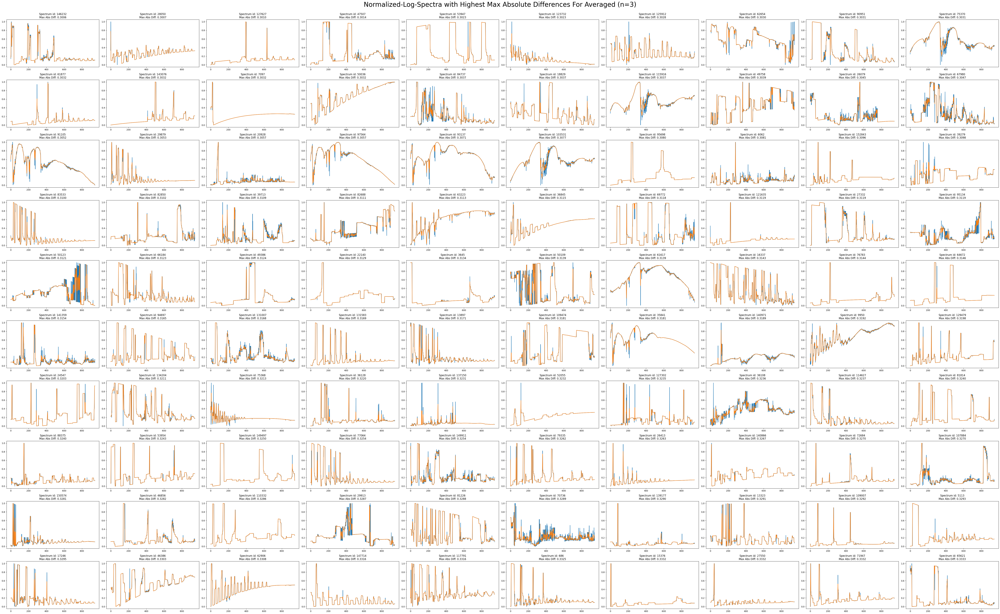

In [221]:
max_diff_indices = np.argsort(max_absolute_differences)[-100:]
indices = max_diff_indices[-100:]

fig, axs = plt.subplots(10, 10, figsize=(16*4, 10*4))
axs = axs.flatten()
fig.suptitle('Normalized-Log-Spectra with Highest Max Absolute Differences For Averaged (n=3)', fontsize=30)
for i, index in enumerate(indices):
    axs[i].plot(spectra_set[index], label='original spectrum')
    axs[i].plot(averaged_spectra_set[index], label='averaged spectrum')
    axs[i].set_title(f'Spectrum id: {index}\nMax Abs Diff: {max_absolute_differences[index]:.4f}')
plt.tight_layout(rect=[0, 0, 1, 0.98])
# plt.show()
figdir = '/Users/ctychen/Desktop/N3AS/figures/'
plt.savefig(figdir + 'top_100_max_abs_diff_averaged_n_3.png')

(153590,)


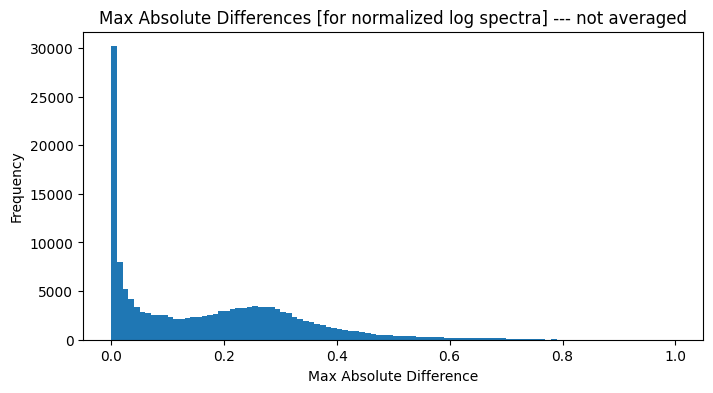

In [222]:
#let's compare how this does for finding the max-abs-diff for the original spectra...
max_absolute_differences = np.max(np.abs(np.diff(spectra_set, axis=1)), axis=1)
print(max_absolute_differences.shape)

#what does the distribution of max absolute differences look like?
plt.figure(figsize=(8, 4))
plt.hist(max_absolute_differences, bins=100)
plt.title('Max Absolute Differences [for normalized log spectra] --- not averaged')
plt.xlabel('Max Absolute Difference')
plt.ylabel('Frequency')
# plt.show()
figdir = '/Users/ctychen/Desktop/N3AS/figures/'
plt.savefig(figdir + 'max_abs_diff_log_spectra_distribution_no_avg.png')

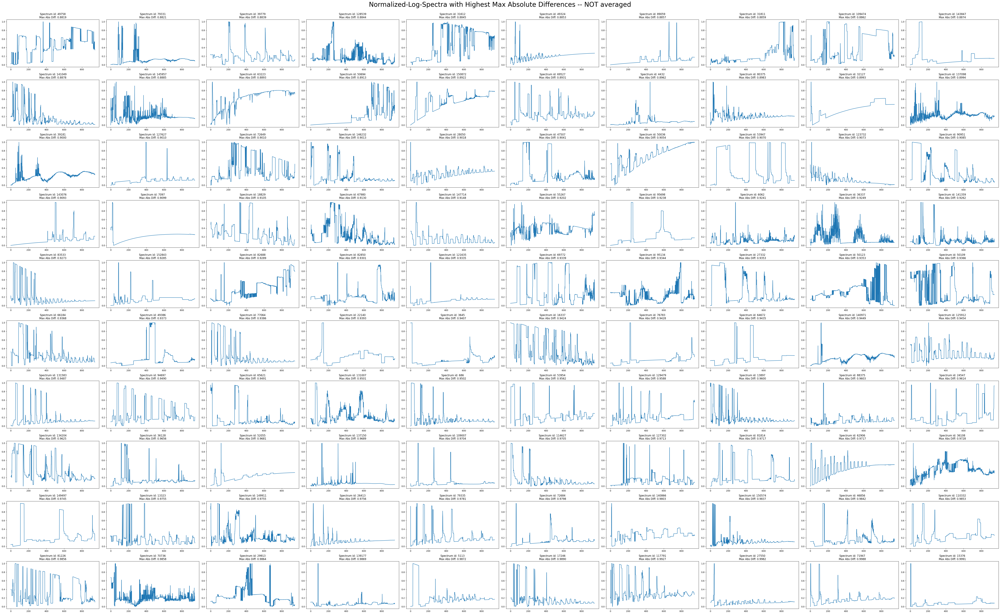

In [200]:
max_diff_indices = np.argsort(max_absolute_differences)[-100:]
indices = max_diff_indices[-100:]

fig, axs = plt.subplots(10, 10, figsize=(16*4, 10*4))
axs = axs.flatten()
fig.suptitle('Normalized-Log-Spectra with Highest Max Absolute Differences -- NOT averaged', fontsize=30)
for i, index in enumerate(indices):
    axs[i].plot(spectra_set[index], label='original spectrum')
    axs[i].set_title(f'Spectrum id: {index}\nMax Abs Diff: {max_absolute_differences[index]:.4f}')
plt.tight_layout(rect=[0, 0, 1, 0.98])
# plt.show()
figdir = '/Users/ctychen/Desktop/N3AS/figures/'
plt.savefig(figdir + 'top_100_max_abs_diff_not_averaged.png')

In [223]:
fig, axs = plt.subplots(20, 20, figsize=(16*4*2, 10*4*2))
axs = axs.flatten()
fig.suptitle('Normalized-Log-Spectra with Highest Max Absolute Differences -- NOT averaged', fontsize=30)
for i, index in enumerate(indices):
    axs[i].plot(spectra_set[index], label='original spectrum')
    axs[i].set_title(f'Spectrum id: {index}\nMax Abs Diff: {max_absolute_differences[index]:.4f}')
plt.tight_layout(rect=[0, 0, 1, 0.98])
# plt.show()
figdir = '/Users/ctychen/Desktop/N3AS/figures/'
plt.savefig(figdir + 'top_400_max_abs_diff_not_averaged.png')

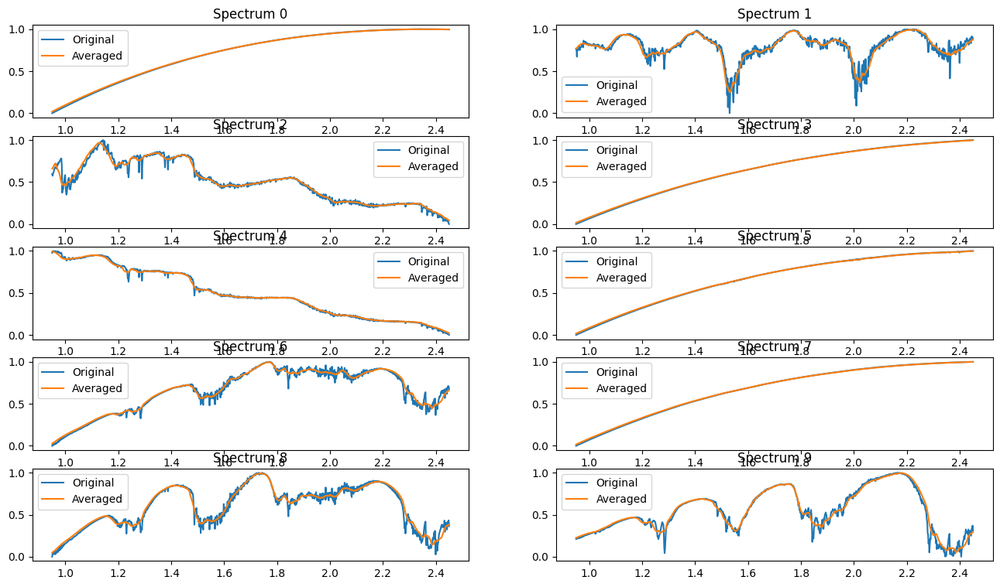

In [172]:
#let's see how well this moving average did by plotting the first 10 spectra to compare...
wavelengths_original = np.linspace(0.95, 2.45, len(spectra_set[0]))
wavelengths_avg = np.linspace(0.95, 2.45, len(averaged_spectra_set[0]))

fig, ax = plt.subplots(5, 2, figsize=(16, 9))
axs = ax.flatten()
for i in range(10):
    axs[i].plot(wavelengths_original, spectra_set[i], label='Original')
    axs[i].plot(wavelengths_avg, averaged_spectra_set[i], label='Averaged')
    axs[i].legend()
    axs[i].set_title(f'Spectrum {i}')
plt.show()

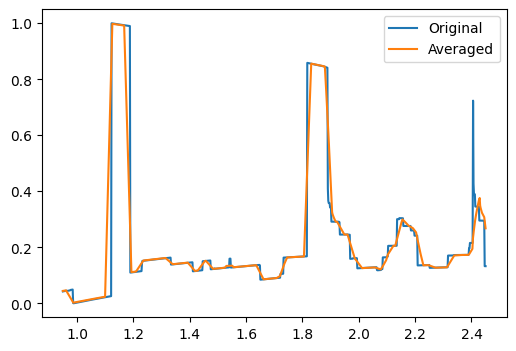

In [173]:
testidx = 149497
plt.figure(figsize=(6, 4))
plt.plot(wavelengths_original, spectra_set[testidx], label='Original')
plt.plot(wavelengths_avg, averaged_spectra_set[testidx], label='Averaged')
plt.legend()
plt.show()

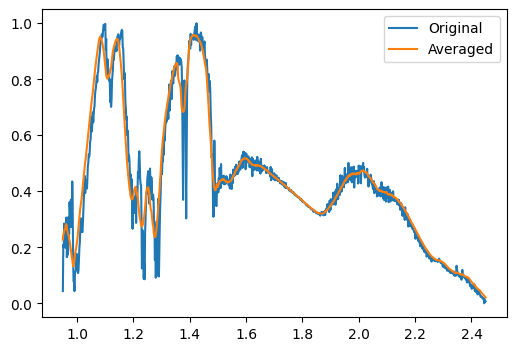

In [174]:
testidx = 77062
plt.figure(figsize=(6, 4))
plt.plot(wavelengths_original, spectra_set[testidx], label='Original')
plt.plot(wavelengths_avg, averaged_spectra_set[testidx], label='Averaged')
plt.legend()
plt.show()

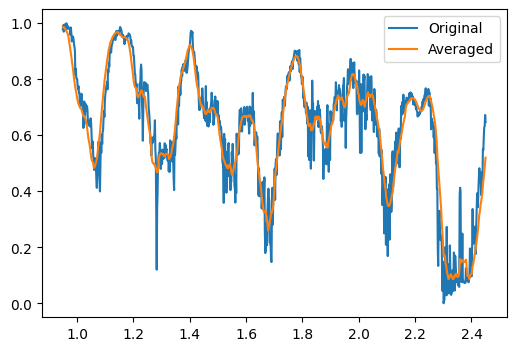

In [175]:
testidx = 86975
plt.figure(figsize=(6, 4))
plt.plot(wavelengths_original, spectra_set[testidx], label='Original')
plt.plot(wavelengths_avg, averaged_spectra_set[testidx], label='Averaged')
plt.legend()
plt.show()

In [176]:
print(len(averaged_spectra_set[0]))
print(averaged_spectra_set.shape)

932
(153590, 932)


In [177]:
#after averaging, length of each spectrum is different - 
n_features = len(averaged_spectra_set[0])
#splitting data into training and testing sets - this time using the averaged spectra!
y_train, y_test = train_test_split(averaged_spectra_set, test_size=0.2, random_state = 137)
#track which indices from the original set of spectra end up in which set
indices_train, indices_test = train_test_split(np.arange(n_samples), test_size=0.2, random_state = 137)

In [ ]:
#some test preprocessing...
#we have already normalized the log flux
#can we try subsampling the data to smooth them out? 

#subsample each spectrum - try keeping each 3rd point
subsampled_spectra_set = spectra_set[:, ::3]
wavelengths = np.linspace(0.95, 2.45, len(spectra_set[0]))
subsampled_wavelengths = wavelengths[::3]
print(subsampled_spectra_set.shape)

In [ ]:
plt.figure(figsize=(10, 5))
plt.plot(subsampled_wavelengths, subsampled_spectra_set[1], label='subsampled')
plt.plot(wavelengths, spectra_set[1], label='original spectrum', alpha=0.5)
plt.legend()
plt.show()

plt.figure(figsize=(10, 5))
plt.plot(subsampled_wavelengths, subsampled_spectra_set[500], label='subsampled')
plt.plot(wavelengths, spectra_set[500], label='original spectrum', alpha=0.5)
plt.legend()
plt.show()

In [178]:
inp = keras.layers.Input(shape=(n_features,)) # input layer with n_features neurons
x = keras.layers.Dense(512, activation="relu")(inp)
x = keras.layers.Dense(128, activation="relu")(x)
x = keras.layers.Dense(64, activation="relu")(x)
x = keras.layers.Dense(32, activation="relu")(x) # (bottleneck layer)
x = keras.layers.Dense(64, activation="relu")(x)
x = keras.layers.Dense(128, activation="relu")(x)
x = keras.layers.Dense(512, activation="relu")(x) 
out = keras.layers.Dense(n_features)(x) # output layer with n_features neurons

autoencoder = keras.models.Model(inp, out) # create model with input and output layers

# compile model
autoencoder.compile(optimizer="adam", loss="mean_squared_error") # use adam optimizer and mean squared error loss function

# print model summary
autoencoder.summary()

# train model with training data and validate with testing data (early stopping is used to avoid overfitting)
history = autoencoder.fit(y_train, y_train, epochs=500, batch_size=32, validation_data=(y_test, y_test),
                callbacks=[keras.callbacks.EarlyStopping(patience=5)]) # this stops training if the validation loss does not decrease for 5 epochs to avoid overfitting

Model: "functional_9"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_4 (InputLayer)      │ (None, 932)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_30 (Dense)                │ (None, 512)            │       477,696 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_31 (Dense)                │ (None, 128)            │        65,664 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_32 (Dense)                │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_33 (Dense)                │ (None, 32)             │         2,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_34 (Dense)                │ (None, 64)             │         2,112 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_35 (Dense)                │ (None, 128)            │         8,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_36 (Dense)                │ (None, 512)            │        66,048 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_37 (Dense)                │ (None, 932)            │       478,116 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,108,292 (4.23 MB)

 Trainable params: 1,108,292 (4.23 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/500
3840/3840 ━━━━━━━━━━━━━━━━━━━━ 23s 6ms/step - loss: 0.0077 - val_loss: 8.1602e-04
Epoch 2/500
3840/3840 ━━━━━━━━━━━━━━━━━━━━ 23s 6ms/step - loss: 4.7237e-04 - val_loss: 2.5362e-04
Epoch 3/500
3840/3840 ━━━━━━━━━━━━━━━━━━━━ 23s 6ms/step - loss: 3.2850e-04 - val_loss: 2.2142e-04
Epoch 4/500
3840/3840 ━━━━━━━━━━━━━━━━━━━━ 23s 6ms/step - loss: 2.7886e-04 - val_loss: 2.0034e-04
Epoch 5/500
3840/3840 ━━━━━━━━━━━━━━━━━━━━ 24s 6ms/step - loss: 2.3345e-04 - val_loss: 1.7616e-04
Epoch 6/500
3840/3840 ━━━━━━━━━━━━━━━━━━━━ 23s 6ms/step - loss: 2.1370e-04 - val_loss: 2.2360e-04
Epoch 7/500
3840/3840 ━━━━━━━━━━━━━━━━━━━━ 23s 6ms/step - loss: 1.9314e-04 - val_loss: 2.4276e-04
Epoch 8/500
3840/3840 ━━━━━━━━━━━━━━━━━━━━ 24s 6ms/step - loss: 1.8830e-04 - val_loss: 1.6230e-04
Epoch 9/500
3840/3840 ━━━━━━━━━━━━━━━━━━━━ 23s 6ms/step - loss: 1.7936e-04 - val_loss: 1.7250e-04
Epoch 10/500
3840/3840 ━━━━━━━━━━━━━━━━━━━━ 23s 6ms/step - loss: 1.6898e-04 - val_loss: 1.5425e-04
Epoch 11/500
3840/3840 

In [180]:
dir = '/Users/ctychen/Desktop/N3AS/models/'
autoencoder.save(dir+"autoencoder_512_128_64_32_128_512_v6.keras")

In [ ]:
dir = '/Users/ctychen/Desktop/N3AS/models/'
autoencoder = keras.models.load_model(dir+"autoencoder_512_128_64_32_128_512_v5.keras")

# compile model
autoencoder.compile(optimizer="adam", loss="mean_squared_error") # use adam optimizer and mean squared error loss function

# print model summary
autoencoder.summary()

# train model with training data and validate with testing data (early stopping is used to avoid overfitting)
history = autoencoder.fit(y_train, y_train, epochs=500, batch_size=32, validation_data=(y_test, y_test),
                callbacks=[keras.callbacks.EarlyStopping(patience=5)]) # this stops training if the validation loss does not decrease for 5 epochs to avoid overfitting

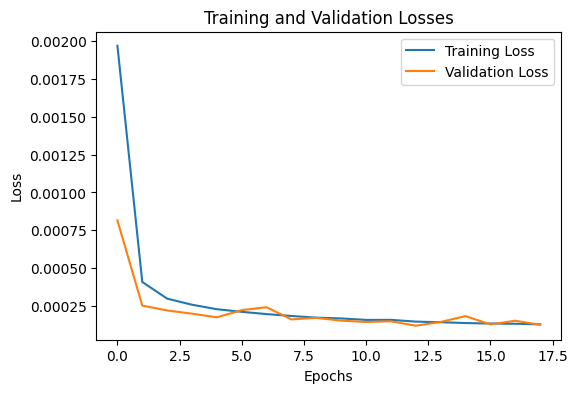

In [181]:
plt.figure(figsize=(6, 4))
plt.plot(history.history["loss"], label="Training Loss")
plt.plot(history.history["val_loss"], label="Validation Loss")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title(f'Training and Validation Losses')
plt.legend()
# plt.show()
figdir = '/Users/ctychen/Desktop/N3AS/figures/'
plt.savefig(figdir + 'autoencoder_v6_loss_layers_512_128_64_32_128_512.png')

In [182]:
#try evaluating the model with testing data
loss = autoencoder.evaluate(y_test, y_test)
print(f'Test Loss: {loss}')

960/960 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 1.2209e-04 
Test Loss: 0.00012685130059253424


960/960 ━━━━━━━━━━━━━━━━━━━━ 1s 782us/step


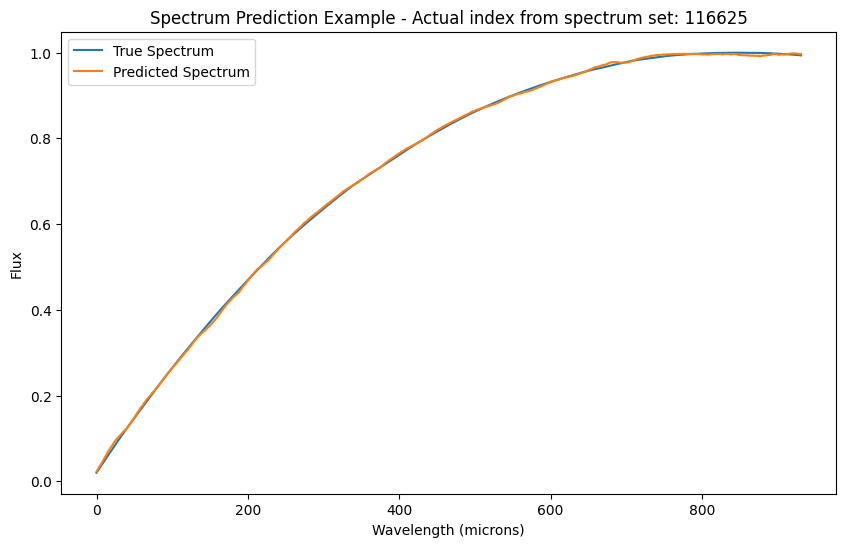

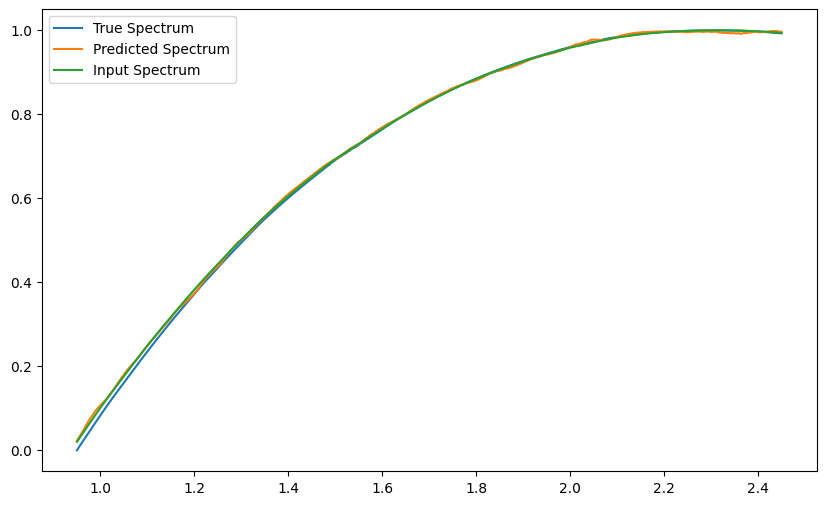

In [183]:
#example predictions
y_pred = autoencoder.predict(y_test)

wavelengths = np.linspace(0.95, 2.45, len(spectra_set[indices_test[0]]))
wavelengths2 = np.linspace(0.95, 2.45, len(averaged_spectra_set[0]))

plt.figure(figsize=(10, 6))
plt.plot(y_test[0], label="True Spectrum")
plt.plot(y_pred[0], label="Predicted Spectrum")
plt.legend()
plt.xlabel("Wavelength (microns)")
plt.ylabel("Flux")
plt.title(f'Spectrum Prediction Example - Actual index from spectrum set: {indices_test[0]}')
plt.show()

plt.figure(figsize=(10, 6))
plt.plot(wavelengths, spectra_set[indices_test[0]], label="True Spectrum")
plt.plot(wavelengths2, y_pred[0], label="Predicted Spectrum")
plt.plot(wavelengths2, y_test[0], label="Input Spectrum")
plt.legend()
plt.show()


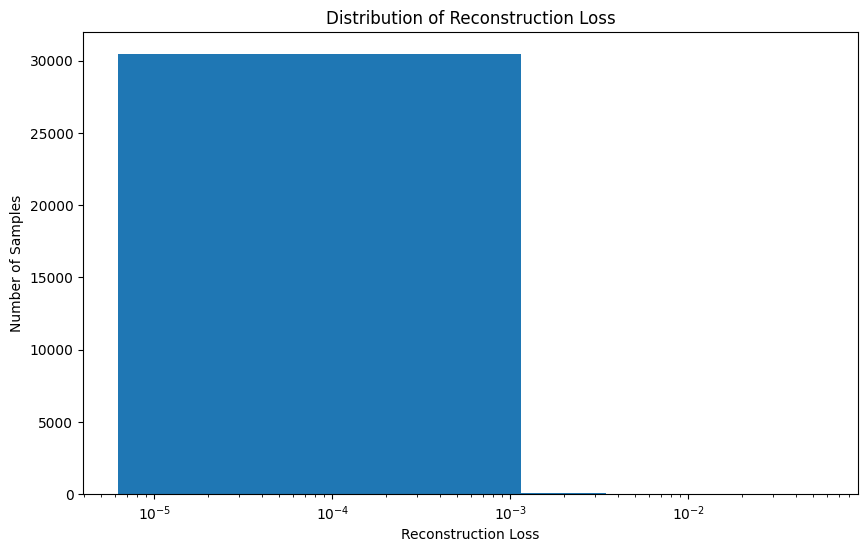

Mean Reconstruction Loss: 0.0001268516981816795
Max Reconstruction Loss: 0.05701975838800017
Min Reconstruction Loss: 6.268682845880461e-06


In [184]:
reconstruction_loss = np.mean((y_pred - y_test)**2, axis=1)

plt.figure(figsize=(10, 6))
plt.hist(reconstruction_loss, bins=50)
plt.xlabel("Reconstruction Loss")
plt.ylabel("Number of Samples")
plt.xscale("log")
plt.title("Distribution of Reconstruction Loss")
plt.show()

print(f'Mean Reconstruction Loss: {np.mean(reconstruction_loss)}')
print(f'Max Reconstruction Loss: {np.max(reconstruction_loss)}')
print(f'Min Reconstruction Loss: {np.min(reconstruction_loss)}')

960/960 ━━━━━━━━━━━━━━━━━━━━ 1s 804us/step
[20689 21978  7954 22693 13251 21666 20823 18732 23077 15625]


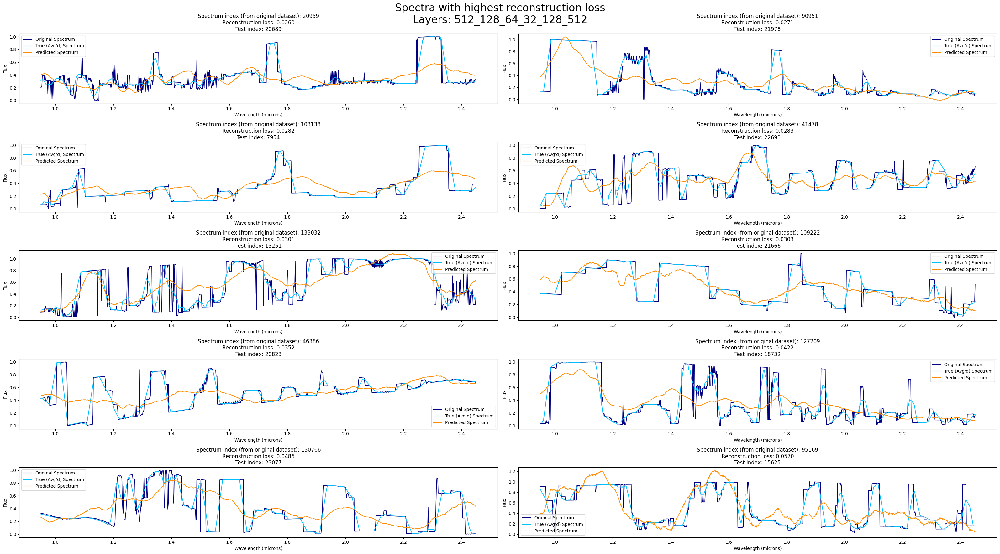

In [185]:
y_pred = autoencoder.predict(y_test)
reconstruction_loss = np.mean((y_pred - y_test)**2, axis=1)
wavelengths = np.linspace(0.95, 2.45, len(y_test[0]))
wavelengths_original = np.linspace(0.95, 2.45, len(spectra_set[0]))

worst_indices = np.argsort(reconstruction_loss)[-10:]
print(worst_indices)

fig, axs = plt.subplots(5, 2, figsize=(16*2, 9*2))
axs = axs.flatten()
for i, idx in enumerate(worst_indices):
    actual_spectrum_set_idx = indices_test[idx]
    axs[i].plot(wavelengths_original, spectra_set[actual_spectrum_set_idx], label="Original Spectrum", color='navy')
    axs[i].plot(wavelengths, y_test[idx], label="True (Avg'd) Spectrum", color='deepskyblue')
    axs[i].plot(wavelengths, y_pred[idx], label="Predicted Spectrum", color='darkorange')
    axs[i].set_title(f'Spectrum index (from original dataset): {actual_spectrum_set_idx}\nReconstruction loss: {reconstruction_loss[idx]:.4f}\nTest index: {idx}')
    axs[i].set_xlabel("Wavelength (microns)")
    axs[i].set_ylabel("Flux")
    axs[i].legend()
plt.tight_layout(rect=[0, 0, 1, 0.97])
plt.suptitle("Spectra with highest reconstruction loss\nLayers: 512_128_64_32_128_512", fontsize=24)
# plt.show()
plt.savefig(figdir + 'autoencoder_v6_10_worst_spectra_layers_512_128_64_32_128_512.png')

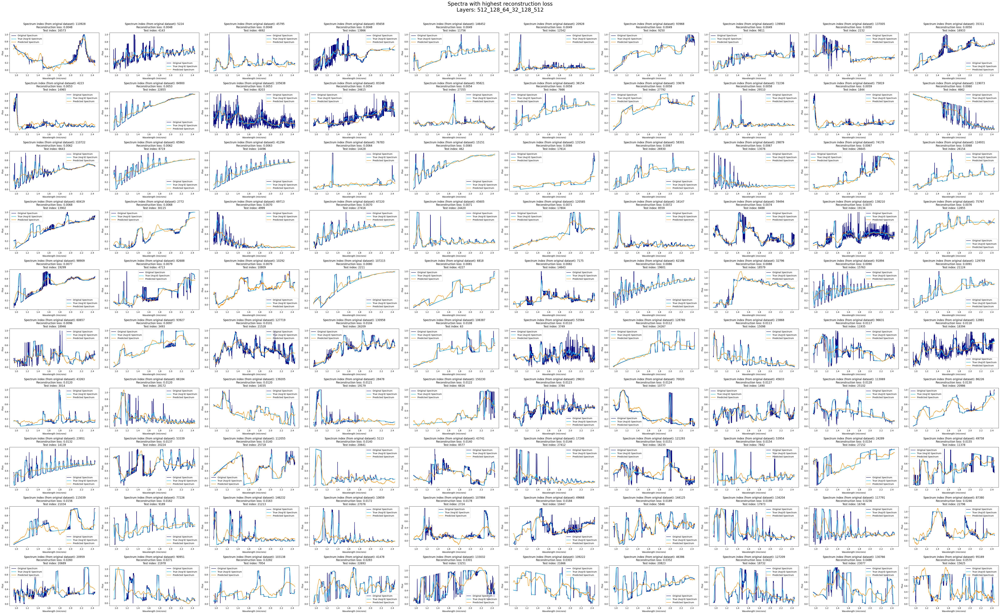

In [186]:
worst_indices = np.argsort(reconstruction_loss)[-100:]
fig, axs = plt.subplots(10, 10, figsize=(16*4, 10*4))
axs = axs.flatten()
for i, idx in enumerate(worst_indices):
    actual_spectrum_set_idx = indices_test[idx]
    axs[i].plot(wavelengths_original, spectra_set[actual_spectrum_set_idx], label="Original Spectrum", color='navy')
    axs[i].plot(wavelengths, y_test[idx], label="True (Avg'd) Spectrum", color='deepskyblue')
    axs[i].plot(wavelengths, y_pred[idx], label="Predicted Spectrum", color='darkorange')
    axs[i].set_title(f'Spectrum index (from original dataset): {actual_spectrum_set_idx}\nReconstruction loss: {reconstruction_loss[idx]:.4f}\nTest index: {idx}')
    axs[i].set_xlabel("Wavelength (microns)")
    axs[i].set_ylabel("Flux")
    axs[i].legend()
plt.tight_layout(rect=[0, 0, 1, 0.95])
plt.suptitle("Spectra with highest reconstruction loss\nLayers: 512_128_64_32_128_512", fontsize=24)
# plt.show()
plt.savefig('/Users/ctychen/Desktop/N3AS/figures/autoencoder_v6_100_spectra_with_highest_reconstruction_loss_512_128_64_32_128_512.png')

In [187]:
worst_indices = np.argsort(reconstruction_loss)[-400:]

fig, axs = plt.subplots(20, 20, figsize=(16*1.5*4, 9.5*1.5*4))
axs = axs.flatten()
for i, idx in enumerate(worst_indices):
    actual_spectrum_set_idx = indices_test[idx]
    axs[i].plot(wavelengths_original, spectra_set[actual_spectrum_set_idx], label="Original Spectrum", color='navy')
    axs[i].plot(wavelengths, y_test[idx], label="True (Avg'd) Spectrum", color='deepskyblue')
    axs[i].plot(wavelengths, y_pred[idx], label="Predicted Spectrum", color='darkorange')
    axs[i].set_title(f'Spectrum index (from original dataset): {actual_spectrum_set_idx}\nReconstruction loss: {reconstruction_loss[idx]:.4f}\nTest index: {idx}')
    axs[i].set_xlabel("Wavelength (microns)")
    axs[i].set_ylabel("Flux")
    axs[i].legend()
plt.tight_layout(rect=[0, 0, 1, 0.97])
plt.suptitle("Spectra with highest reconstruction loss\n[512_128_64_32_128_512]", fontsize=24)
# plt.show()
plt.savefig('/Users/ctychen/Desktop/N3AS/figures/autoencoder_v6_400_spectra_with_most_reconstruction_loss_512_128_64_32_128_512.png')